# BBM416 Computer Vision Project - Distracted Driver Classification

In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import random
import cv2

import seaborn as sns
import csv
import keras.utils as image

from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix

import tensorflow as tf
from keras import models
from keras import layers

from tensorflow.keras.callbacks import EarlyStopping

import plotly.express as px
from datasets import load_dataset
from tensorflow.keras.models import load_model


from tf_explain.core.grad_cam import GradCAM



In [2]:
image_size = (256, 256)
batch_size = 128
directory_train= "distracted_drivers/train/"


train_ds, val_ds = tf.keras.utils.image_dataset_from_directory(
    directory=directory_train,
    labels='inferred',
    #color_mode="grayscale",
    label_mode='categorical',
    subset="both",
    seed=1337,
    validation_split=0.2,
    image_size=image_size,
    batch_size=batch_size,
)

Found 15200 files belonging to 10 classes.
Using 12160 files for training.
Using 3040 files for validation.


In [278]:
image_size = (256, 256)
directory_test= "distracted_drivers/test/"

test_ds = tf.keras.utils.image_dataset_from_directory(
    directory=directory_test,
    labels='inferred',
    #color_mode="grayscale",
    label_mode='categorical',
    seed=1337,
    image_size=image_size,
)

Found 3040 files belonging to 10 classes.


## Dataset

In [4]:
dataset = load_dataset("distracted_drivers", data_dir="train")

Resolving data files: 100%|██████████| 15200/15200 [00:00<00:00, 28237.94it/s]
Found cached dataset imagefolder (/Users/hryhrmnrn_air/.cache/huggingface/datasets/imagefolder/distracted_drivers-19a9f301063daba7/0.0.0/37fbb85cc714a338bea574ac6c7d0b5be5aff46c1862c1989b20e0771199e93f)
100%|██████████| 1/1 [00:00<00:00, 44.06it/s]


In [6]:
rows = zip(dataset["train"]["label"], dataset["train"]["image"])

In [7]:
with open('data.csv',"w") as file:
    writer = csv.writer(file)
    field = ["label", "image"]
    
    writer.writerow(field)
    for label,image in rows:
        writer.writerow([label,image])


In [8]:
dataset = pd.read_csv("data.csv")

dataset['label'] = dataset['label'].map({
0: "normal driving",
1: "texting - right",
2: "talking on the phone - right",
3: "texting - left",
4: "talking on the phone - left",
5: "operating the radio",
6: "drinking",
7: "reaching behind",
8: "hair and makeup",
9: "talking to passenger"
})


In [9]:
px.histogram(dataset, x="label", color="label", title="Number of images by categories ")

In [82]:
classes = ['c0', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9']

class_def = {"c0": "normal driving",
"c1": "texting - right",
"c2": "talking on the phone - right",
"c3": "texting - left",
"c4": "talking on the phone - left",
"c5": "operating the radio",
"c6": "drinking",
"c7": "reaching behind",
"c8": "hair and makeup",
"c9": "talking to passenger"}

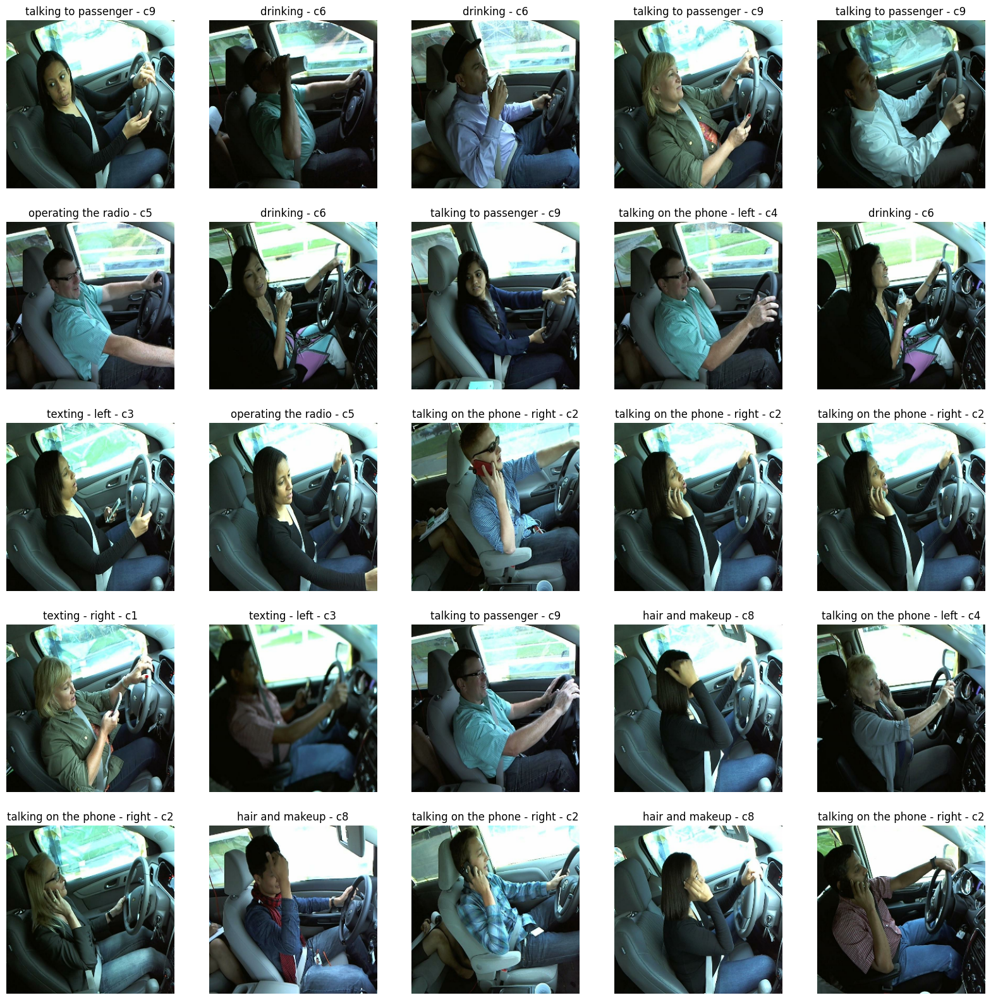

In [132]:
plt.figure(figsize=(20,20))
for images,labels in train_ds.take(11):
    labels = labels.numpy()
    for i in range(25):
        ax = plt.subplot(5, 5, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        plt.title(class_def[classes[labels[i].argmax()]] + " - " + classes[labels[i].argmax()])
        plt.axis("off")

## Model

### Model Creation

In [219]:
model = models.Sequential()
model.add(layers.Conv2D(32, (3, 3), activation='relu',input_shape=(256, 256, 3)))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(64, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(128, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(256, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Conv2D(512, (3, 3), activation='relu'))
model.add(layers.MaxPooling2D((2, 2)))
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dense(512, activation='relu'))
model.add(layers.Dense(128, activation='relu'))
model.add(layers.Dense(10, activation='softmax'))

In [223]:
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_10 (Conv2D)          (None, 254, 254, 32)      896       
                                                                 
 max_pooling2d_10 (MaxPooli  (None, 127, 127, 32)      0         
 ng2D)                                                           
                                                                 
 conv2d_11 (Conv2D)          (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_11 (MaxPooli  (None, 62, 62, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_12 (Conv2D)          (None, 60, 60, 128)       73856     
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 30, 30, 128)      

In [220]:
model.compile(
    optimizer="rmsprop",
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [221]:
# early stopping to stop overfitting
early_stopping = EarlyStopping(monitor='val_accuracy',min_delta=0.01,patience=3)

### Training Model

In [222]:
history = model.fit(
      train_ds,
      epochs=50,
      validation_data=val_ds,
      callbacks=[early_stopping])

Epoch 1/50
95/95 [==============================] - 489s 5s/step - loss: 10.4874 - accuracy: 0.1781 - val_loss: 1.6732 - val_accuracy: 0.3280
Epoch 2/50
95/95 [==============================] - 587s 6s/step - loss: 1.2464 - accuracy: 0.5633 - val_loss: 0.5732 - val_accuracy: 0.8197
Epoch 3/50
95/95 [==============================] - 629s 7s/step - loss: 0.5097 - accuracy: 0.8341 - val_loss: 0.3242 - val_accuracy: 0.8957
Epoch 4/50
95/95 [==============================] - 650s 7s/step - loss: 0.2738 - accuracy: 0.9200 - val_loss: 0.1616 - val_accuracy: 0.9576
Epoch 5/50
95/95 [==============================] - 745s 8s/step - loss: 0.1708 - accuracy: 0.9516 - val_loss: 0.1508 - val_accuracy: 0.9618
Epoch 6/50
95/95 [==============================] - 730s 8s/step - loss: 0.1648 - accuracy: 0.9595 - val_loss: 0.1394 - val_accuracy: 0.9645
Epoch 7/50
95/95 [==============================] - 691s 7s/step - loss: 0.1163 - accuracy: 0.9701 - val_loss: 0.3525 - val_accuracy: 0.9102


### Saving Model

In [224]:
model.save("model.h5")
print("Saved model to disk")

Saved model to disk


/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/keras/src/engine/training.py:3000: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



### Loading Model

In [225]:
model = load_model('model.h5')
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_10 (Conv2D)          (None, 254, 254, 32)      896       
                                                                 
 max_pooling2d_10 (MaxPooli  (None, 127, 127, 32)      0         
 ng2D)                                                           
                                                                 
 conv2d_11 (Conv2D)          (None, 125, 125, 64)      18496     
                                                                 
 max_pooling2d_11 (MaxPooli  (None, 62, 62, 64)        0         
 ng2D)                                                           
                                                                 
 conv2d_12 (Conv2D)          (None, 60, 60, 128)       73856     
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 30, 30, 128)      

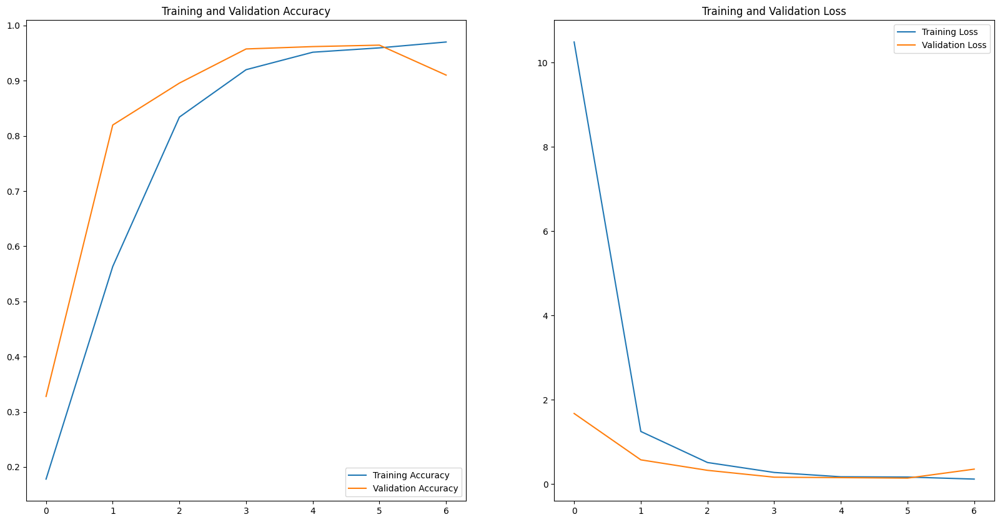

In [226]:
# visualizing accuracy and losses
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = history.epoch

plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

## Testing Model

In [286]:
test_loss, test_accuracy = model.evaluate(test_ds)


95/95 [==============================] - 23s 236ms/step - loss: 0.3471 - accuracy: 0.9105


In [228]:
predictions, real_labels = list(), list()

for images, labels in test_ds:
    labels = labels.numpy()
    for i in range(images.shape[0]):
        img = np.array(images[i], dtype = 'float32')
        img = np.expand_dims(img, axis=0)
        prediction = model.predict(img)
        print("Real: {}".format(class_def[classes[np.argmax(labels[i])]]) + " - " + 'Predicted: {}'.format(class_def.get('c{}'.format(np.argmax(prediction)))))
        predictions.append(np.argmax(prediction))
        real_labels.append(np.argmax(labels[i]))


1/1 [==============================] - 0s 59ms/step
Real: texting - left - Predicted: texting - left
1/1 [==============================] - 0s 22ms/step
Real: texting - left - Predicted: normal driving
1/1 [==============================] - 0s 18ms/step
Real: talking on the phone - left - Predicted: talking on the phone - left
1/1 [==============================] - 0s 18ms/step
Real: normal driving - Predicted: normal driving
1/1 [==============================] - 0s 18ms/step
Real: reaching behind - Predicted: reaching behind
1/1 [==============================] - 0s 18ms/step
Real: texting - right - Predicted: texting - right
1/1 [==============================] - 0s 19ms/step
Real: talking to passenger - Predicted: talking to passenger
1/1 [==============================] - 0s 18ms/step
Real: texting - left - Predicted: normal driving
1/1 [==============================] - 0s 18ms/step
Real: talking on the phone - left - Predicted: talking on the phone - left
1/1 [==================

1/1 [==============================] - 0s 19ms/step


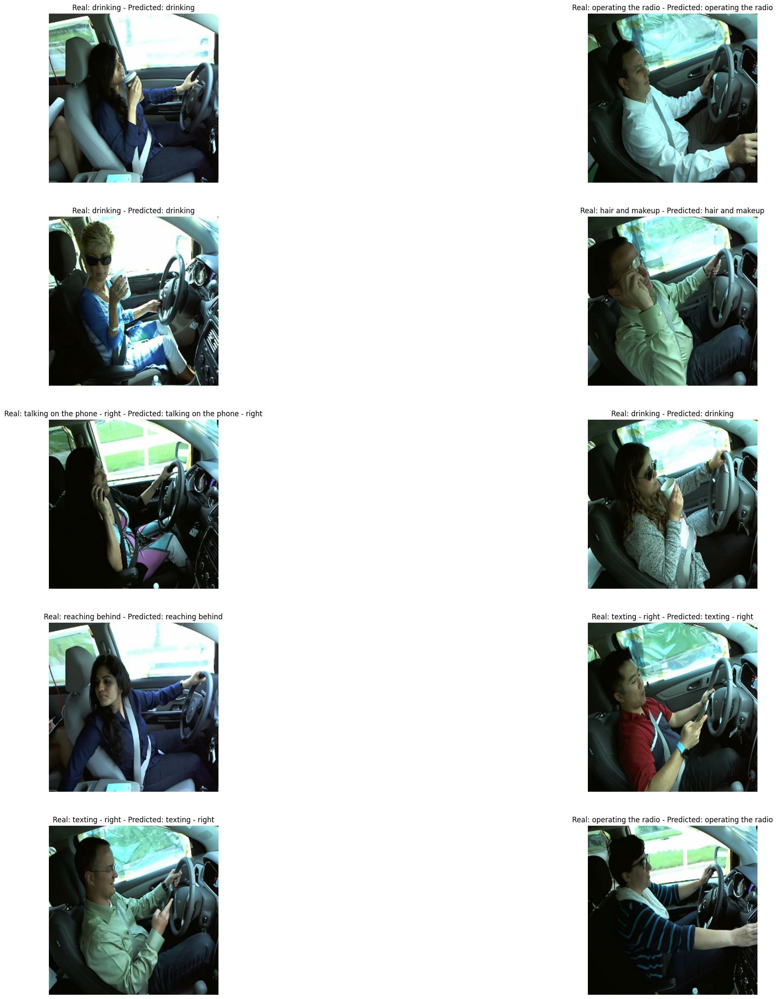

In [279]:
plt.figure(figsize=(30,30))

for images,labels in test_ds.take(11):
    labels = labels.numpy()
    for i in range(10):
        ax = plt.subplot(5, 2, i + 1)
        plt.imshow(images[i].numpy().astype("uint8"))
        img = np.array(images[i], dtype = 'float32')
        img = np.expand_dims(img, axis=0)
        prediction = model.predict(img)
        plt.title("Real: {}".format(class_def[classes[labels[i].argmax()]]) + " - " + 'Predicted: {}'.format(class_def.get('c{}'.format(np.argmax(prediction)))))
        plt.axis("off")

## Evaluation of the Model

In [240]:
target_names = ["normal driving",
"texting - right",
"talking on the phone - right",
"texting - left",
"talking on the phone - left",
"operating the radio",
"drinking",
"reaching behind",
"hair and makeup",
"talking to passenger"]

print(classification_report(real_labels, predictions, target_names=target_names))

                              precision    recall  f1-score   support

              normal driving       0.84      0.94      0.89       304
             texting - right       0.95      0.98      0.96       304
talking on the phone - right       0.95      0.99      0.97       304
              texting - left       0.99      0.54      0.70       304
 talking on the phone - left       0.98      0.93      0.95       304
         operating the radio       0.98      0.98      0.98       304
                    drinking       0.99      0.92      0.95       304
             reaching behind       0.99      0.94      0.97       304
             hair and makeup       0.71      0.96      0.81       304
        talking to passenger       0.86      0.93      0.89       304

                    accuracy                           0.91      3040
                   macro avg       0.92      0.91      0.91      3040
                weighted avg       0.92      0.91      0.91      3040



<Axes: >

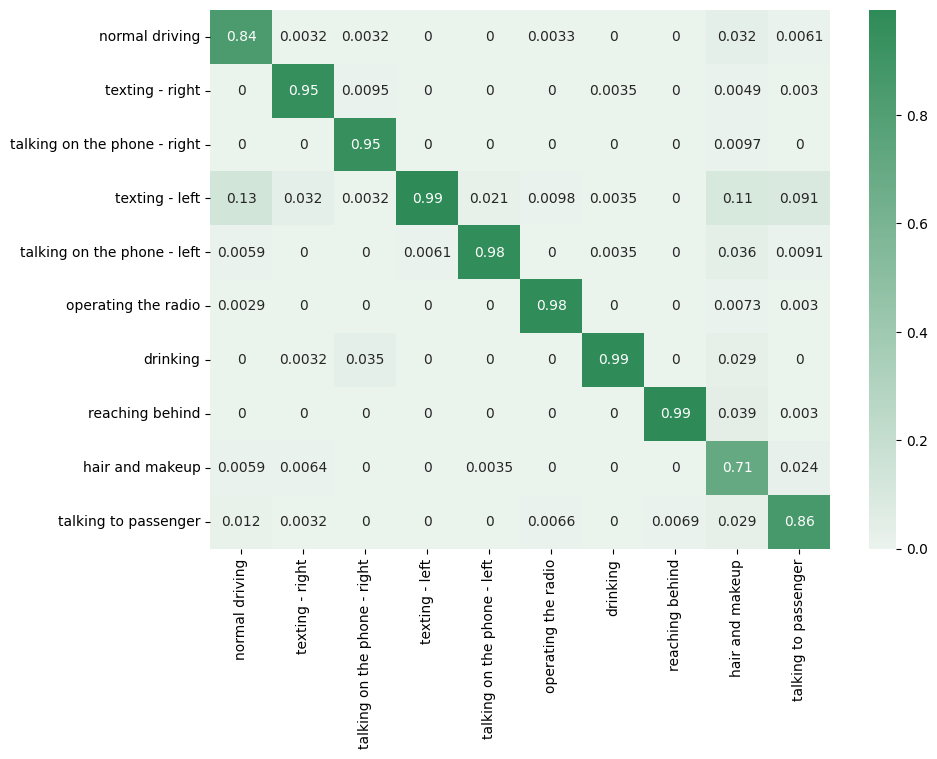

In [241]:
result = confusion_matrix(real_labels, predictions , normalize='pred')

df_cm = pd.DataFrame(result, index = [i for i in class_def.values()],
                  columns = [i for i in class_def.values()])

plt.figure(figsize = (10,7))
color = sns.light_palette("seagreen", as_cmap=True)
sns.heatmap(df_cm, annot=True, cmap=color)

In [233]:
def Heatmap(class_name, outputs):
    fig = plt.figure(figsize=(20, 8))
    print('\n\n','*' * 60, class_def[class_name].capitalize(), '*' * 60, '\n\n')
    for i in range(10):
      plt.subplot(2, 5, i + 1)
      plt.imshow(outputs[i])
      plt.xticks([])
      plt.yticks([])
    plt.show()



 ************************************************************ Normal driving ************************************************************ 




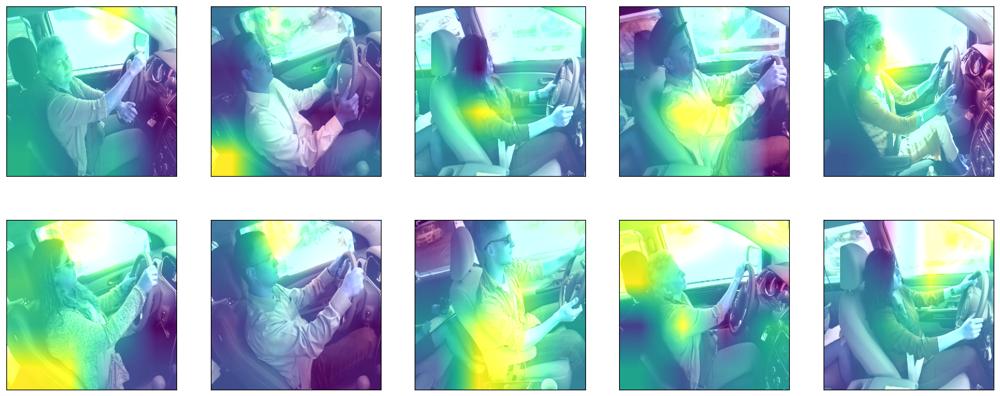



 ************************************************************ Texting - right ************************************************************ 




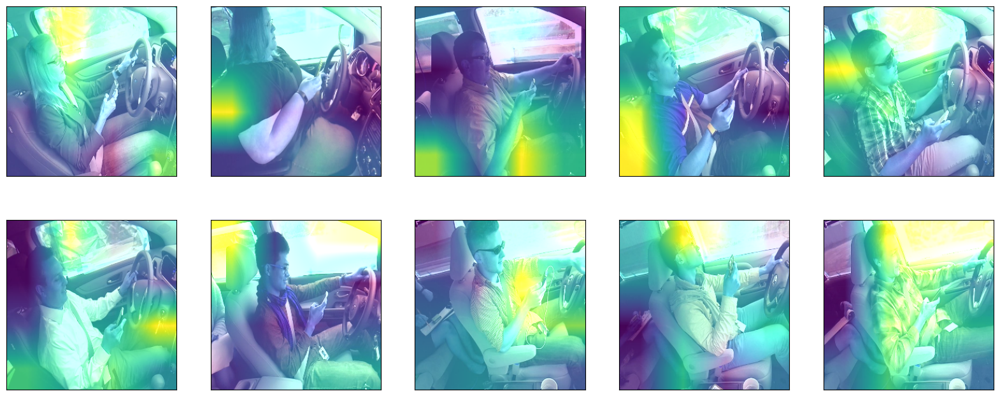



 ************************************************************ Talking on the phone - right ************************************************************ 




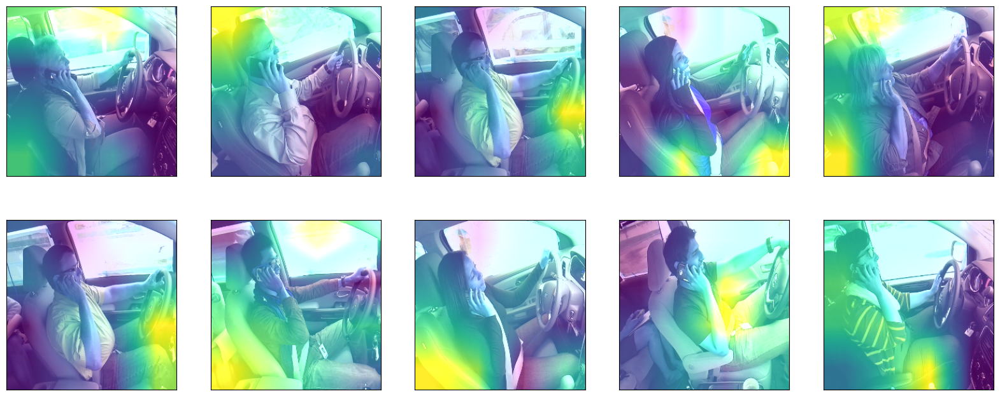



 ************************************************************ Texting - left ************************************************************ 




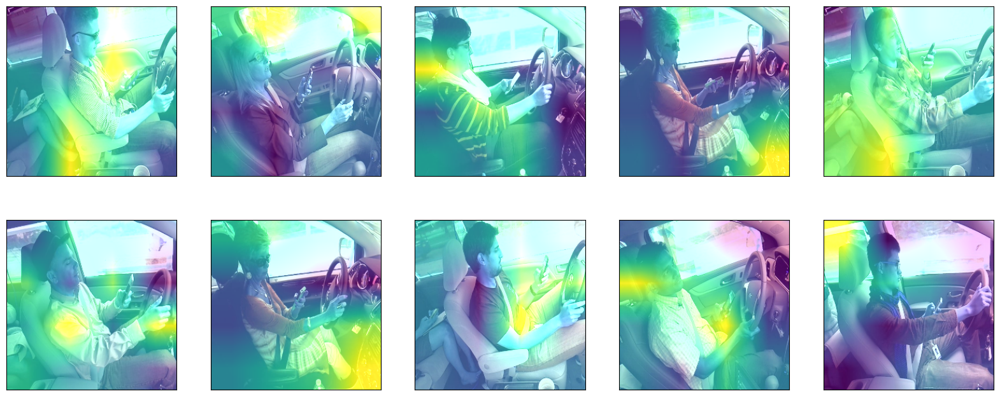



 ************************************************************ Talking on the phone - left ************************************************************ 




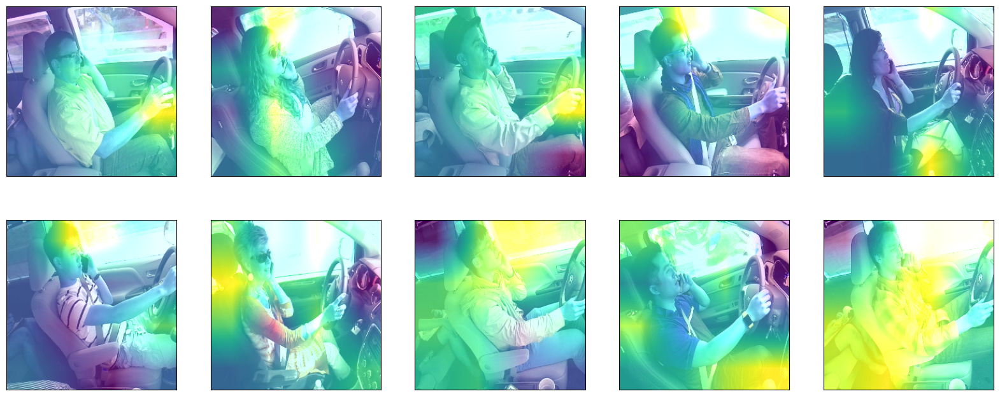



 ************************************************************ Operating the radio ************************************************************ 




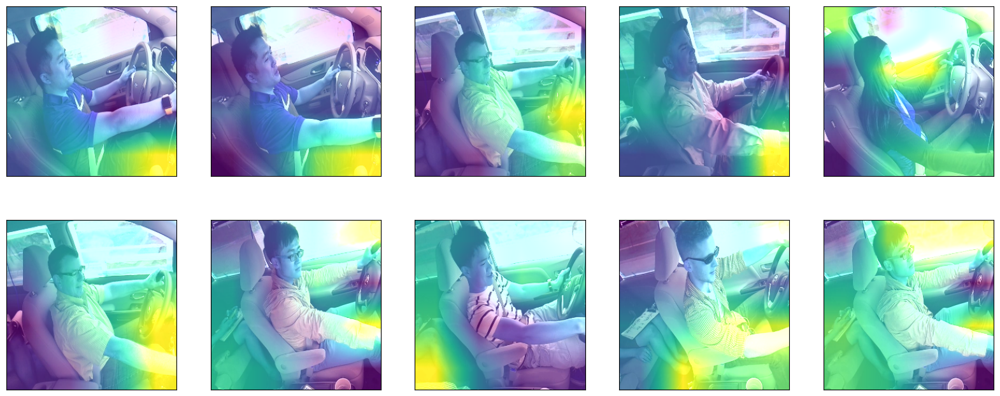



 ************************************************************ Drinking ************************************************************ 




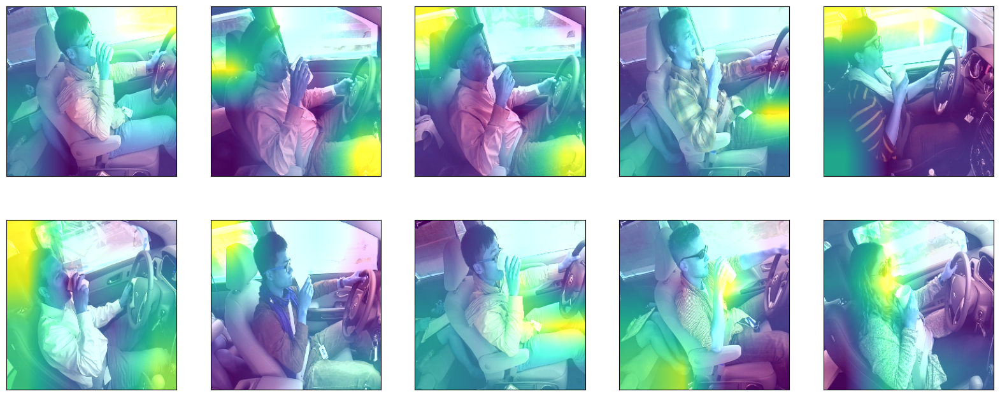



 ************************************************************ Reaching behind ************************************************************ 




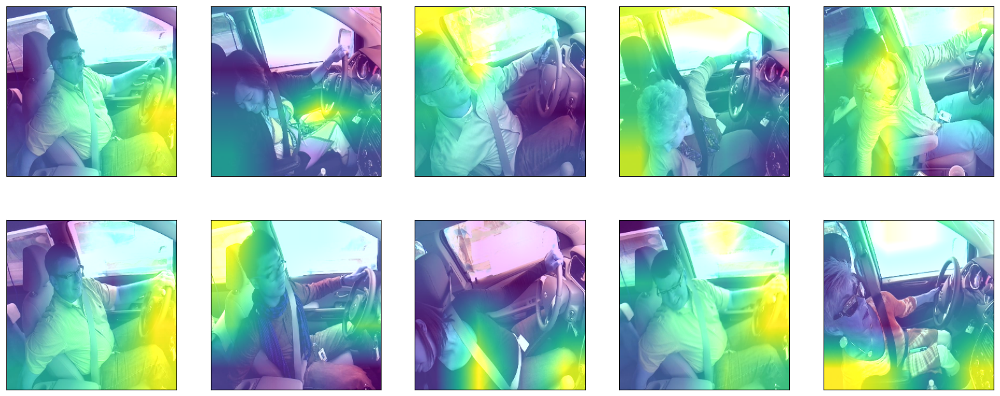



 ************************************************************ Hair and makeup ************************************************************ 




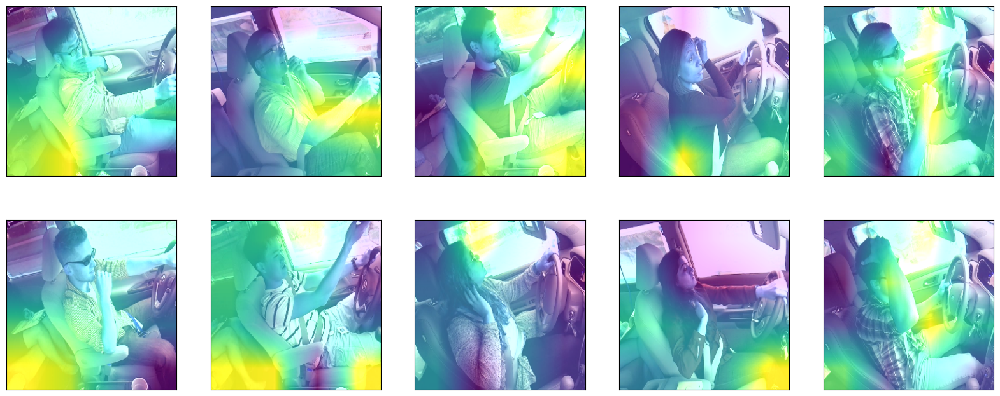



 ************************************************************ Talking to passenger ************************************************************ 




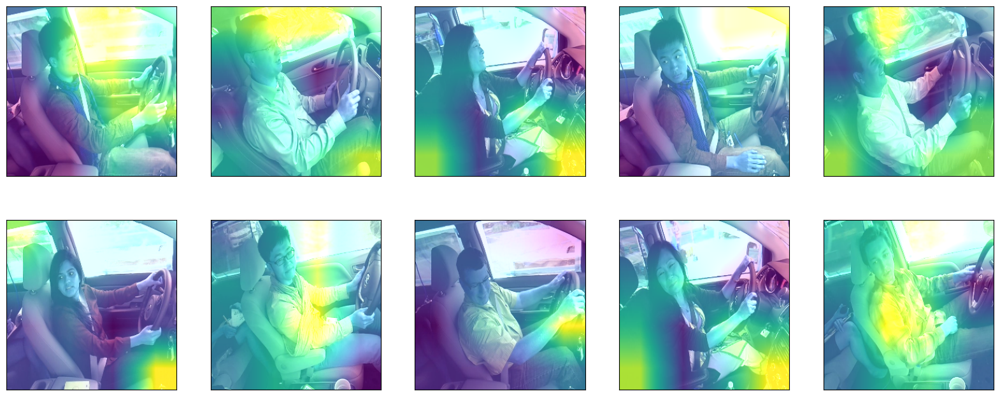

In [290]:
for idx, class_name in enumerate(class_def.keys()):
  output_data = []
  for i in range(10):

      img_path = f"{directory_train}/{class_name}/{random.sample(os.listdir(f'{directory_train}/{class_name}'),1)[0]}"
      img = cv2.imread(img_path)
      img = cv2.resize(img, (256,256))
      data = ([img], None)

      explainer = GradCAM()
      output = explainer.explain(validation_data = data, model = model, class_index = idx, layer_name = 'conv2d_15')
      output_data.append(output)
  Heatmap(class_name, output_data)

In [236]:
layer1 = models.Model(inputs=model.input, outputs=model.get_layer('conv2d_10').output)
layer2 = models.Model(inputs=model.input, outputs=model.get_layer('conv2d_13').output)
layer3 = models.Model(inputs=model.input, outputs=model.get_layer('conv2d_15').output)



 ************************************************************ Normal driving ************************************************************ 




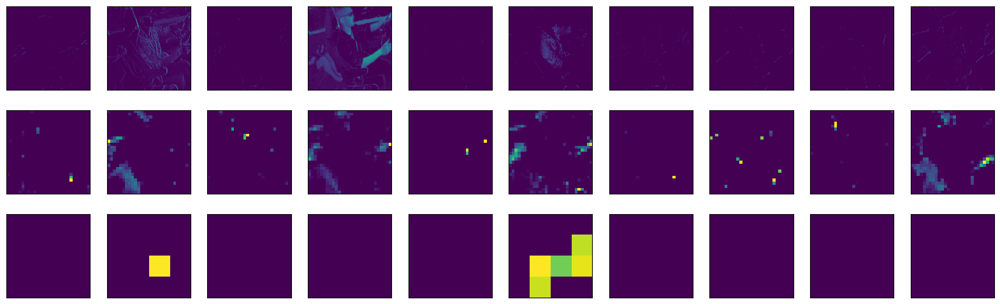



 ************************************************************ Texting - right ************************************************************ 




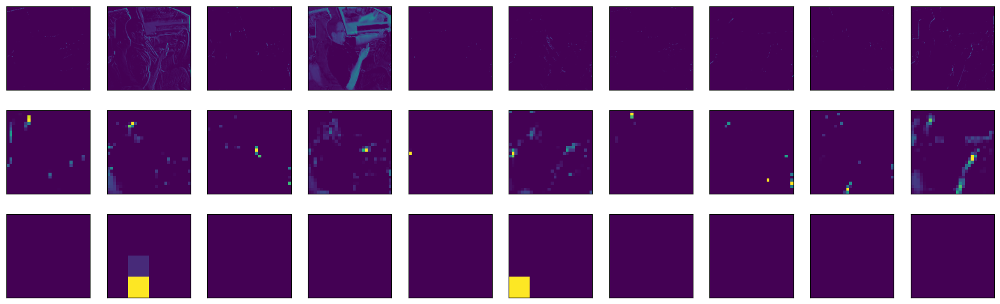



 ************************************************************ Talking on the phone - right ************************************************************ 




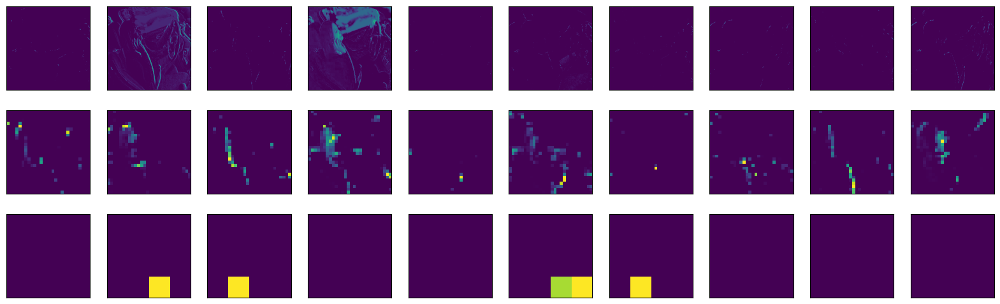



 ************************************************************ Texting - left ************************************************************ 




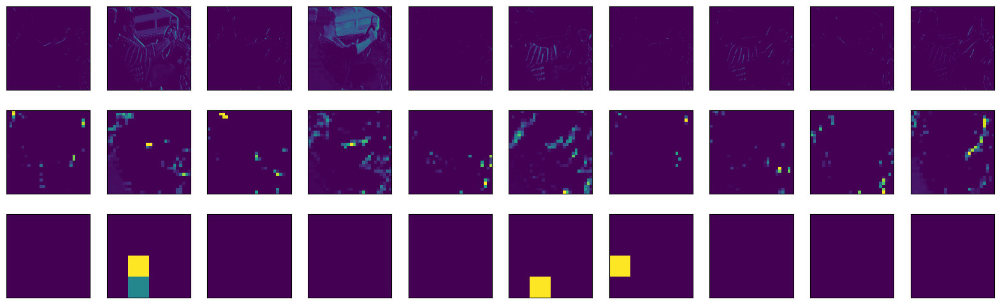



 ************************************************************ Talking on the phone - left ************************************************************ 




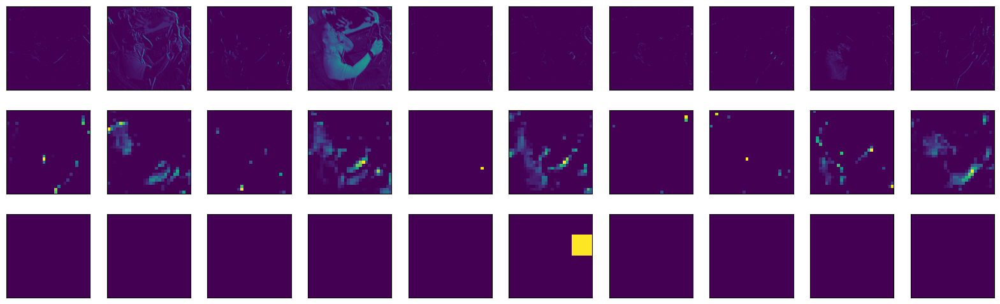



 ************************************************************ Operating the radio ************************************************************ 




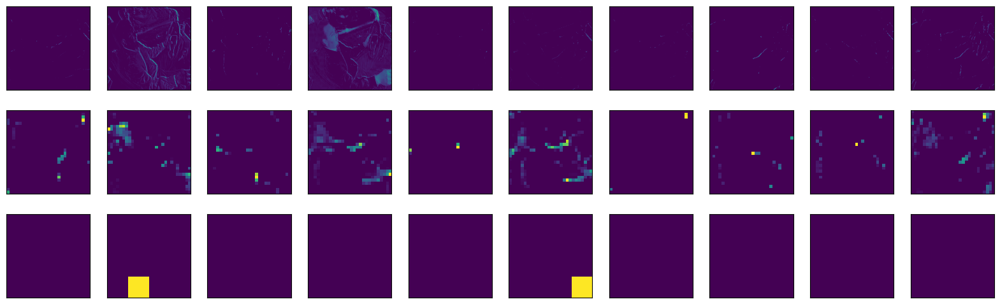



 ************************************************************ Drinking ************************************************************ 




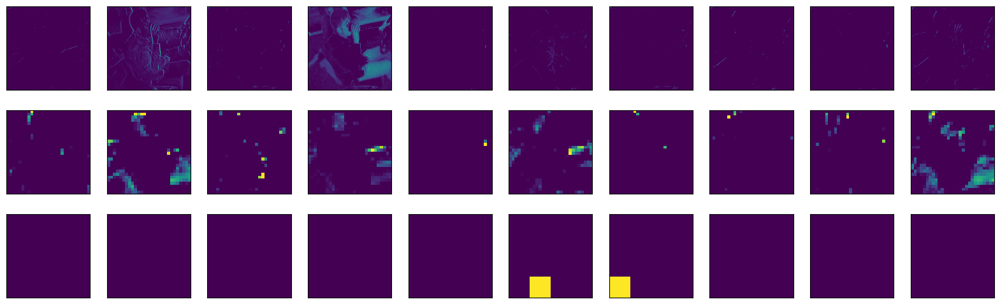



 ************************************************************ Reaching behind ************************************************************ 




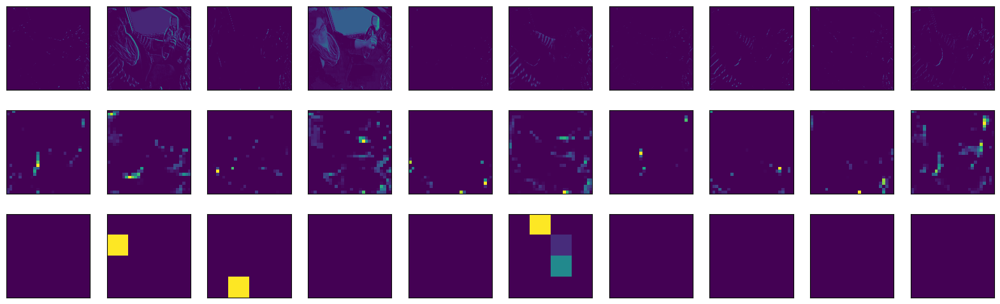



 ************************************************************ Hair and makeup ************************************************************ 




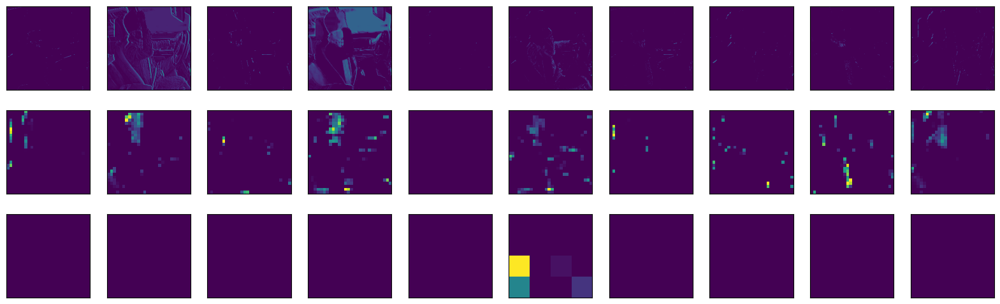



 ************************************************************ Talking to passenger ************************************************************ 




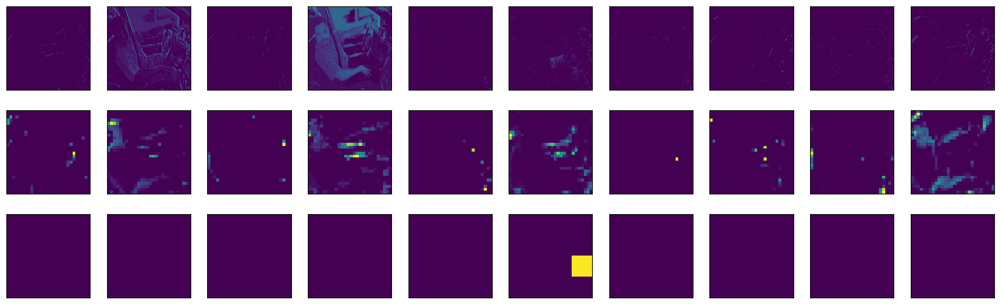

In [237]:
for ind, i in enumerate(class_def.keys()):
  
  img_path = f"{directory_train}/{i}/{random.sample(os.listdir(f'{directory_train}/{i}'),1)[0]}"
  img = image.load_img(img_path, target_size=(256, 256))
  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)

  
  layer1_activations = layer1.predict(x, verbose= 0)
  layer2_activations = layer2.predict(x, verbose= 0)
  layer3_activations = layer3.predict(x, verbose= 0)

  print('\n\n','*' * 60, class_def[i].capitalize(), '*' * 60, '\n\n')
  plt.figure(figsize=(20, 6))

  
  for i in range(10):
    
    plt.subplot(3, 10, i+1)
    plt.imshow(layer1_activations[0, :, :, i], cmap='viridis')
    plt.xticks([])
    plt.yticks([])

    plt.subplot(3, 10, i+11)
    plt.imshow(layer2_activations[0, :, :, 10 + i], cmap='viridis')
    plt.xticks([])
    plt.yticks([])

    plt.subplot(3, 10, i + 21)
    plt.imshow(layer3_activations[0, :, :, 20 + i], cmap='viridis')
    plt.xticks([])
    plt.yticks([])
  plt.show()
  plt.show()